# Setup Environment

Here's an attempt at understanding Brian Long's code that quickly digressed into me doing different things (sorry!). This is a work-in-progress; I'm looking for feedback + suggestions on my approach. 

In [78]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
cd blong/raw

/Users/ajc/google_drive/scratch/starfish/brian_long/blong/raw


In [3]:
# stdlib
from glob import glob
import os, json
from collections import Counter
from copy import deepcopy
from functools import partial
import warnings

# images
import pandas as pd
import numpy as np
import skimage.io
import scipy.io
from scipy import ndimage
from trackpy import bandpass
import cv2
from skimage import img_as_ubyte
from skimage.morphology import white_tophat, disk

# plotting
import matplotlib.pyplot as plt
from showit import image, tile
from starfish.viz import tile_lims
plt.style.use('default')

# starfish
from starfish.io import Stack

# Define the experiment.json for Brian Long's Data

Map channels to integer indices. We exclude the DAPI channel, which goes into `aux`. 

In [4]:
fluor_to_file_mapping = {
    "488": 0,
    "561": 1,
    "640": 2
}

In [5]:
org_json = {}

experiment.json has 3 sections: data, aux, and metadata. 

## Define Data section

In [6]:
data = []
for f in glob('*.tif'):
    _, _, suffix = f.partition('Bandpass')
    file_ = os.path.basename(f)
    ch, z = suffix.strip('.tif').split('_')
    if ch == '405': 
        continue  # DAPI
    data.append({
        "hyb": 0,
        "ch": fluor_to_file_mapping[ch],
        "file": file_,
        "z": int(z)
    })

## Define Aux section

In [7]:
# define the aux section
# fake this by just including one of them
aux = [
    {
        "type": "dapi",
        "file": 'img_000000000_Bandpass405_000.tif',
        "format": "TIFF"
    }
]

## Define the metadata section

In [8]:
# count the z-sections in the data that was provided
z = max(Counter(v['ch'] for v in data).values())

metadata = {
    "num_hybs": 1,
    "num_chs": 3,
    "shape": [2048, 2048, z],
    "is_volume": True, 
    "format": "TIFF"
}

Write the full org.json to disk

In [9]:
with open('org.json', 'w') as f:
    json.dump(dict(data=data, aux=aux, metadata=metadata), f)

Visualize the metadata file

In [10]:
!cat org.json | jq .metadata

{
  "num_hybs": 1,
  "num_chs": 3,
  "shape": [
    2048,
    2048,
    34
  ],
  "is_volume": true,
  "format": "TIFF"
}


Visualize the data organization

In [11]:
!cat org.json | jq . | head -n 14
!echo "..."

{
  "data": [
    {
      "hyb": 0,
      "ch": 1,
      "file": "img_000000000_Bandpass561_023.tif",
      "z": 23
    },
    {
      "hyb": 0,
      "ch": 1,
      "file": "img_000000000_Bandpass561_022.tif",
      "z": 22
    },
...


# Create a codebook

Codebooks should map genes to channels and take on the following (example) structure:
```
[
  {
    "codeword": [
      { "h": 0, "c": 0, "v": 1 },
      { "h": 0, "c": 1, "v": 1 },
      { "h": 1, "c": 1, "v": 1 }
    ],
    "gene": "SCUBE2"
  },
  {
    "codeword": [
      { "h": 0, "c": 0, "v": 1 },
      { "h": 1, "c": 1, "v": 1 }
    ],
    "gene": "BRCA"
  },...
]
```
for the provided data, we have only one FOV. Based on this, create a codebook, dump it to disk, and visualize the output:

In [12]:
codebook = []
gene_to_channel = (("Nmnt", "488"), ("Ptprt", "561"), ("Nxph2", "640"))
for gene, channel in gene_to_channel:
    codebook.append({
        "codeword": [{
            "h": 0,
            "c": fluor_to_file_mapping[channel],
            "v": 1
        }],
        "gene": gene
    })

with open('codebook.json', 'w') as f:
    json.dump(codebook, f)

!cat codebook.json | jq

[
  {
    "codeword": [
      {
        "h": 0,
        "c": 0,
        "v": 1
      }
    ],
    "gene": "Nmnt"
  },
  {
    "codeword": [
      {
        "h": 0,
        "c": 1,
        "v": 1
      }
    ],
    "gene": "Ptprt"
  },
  {
    "codeword": [
      {
        "h": 0,
        "c": 2,
        "v": 1
      }
    ],
    "gene": "Nxph2"
  }
]


# Load the processed data

Here I load the processed results provided by brian

In [166]:
def load_blong_results(npy_file):
    """load smFISH results"""
    res = np.load(npy_file)


    df = pd.DataFrame(
        res, 
        columns=['x', 'y', 'z', 'brightness', 'radius^2', 'redundant_radius', 'peak', 'x^2', 'y^2', 'z^2', 'category']
    ).drop('redundant_radius', axis=1)
    df.index.name = 'spot_id'
    return df

In [167]:
res_488 = load_blong_results(os.path.expanduser('~/google_drive/scratch/starfish/brian_long/10-Pos_002_002_488_0.npy'))
res_640 = load_blong_results(os.path.expanduser('~/google_drive/scratch/starfish/brian_long/10-Pos_002_002_640_0.npy'))
res_561 = load_blong_results(os.path.expanduser('~/google_drive/scratch/starfish/brian_long/10-Pos_002_002_561_0.npy'))

# Look at the data

In [15]:
s = Stack()
s.read('org.json')

# our data is in uint, so cast it there. This should not cause any loss of precision. 
s.image._data = s.image._data.astype(np.uint16)

In [16]:
# look at a the channels in a few of the z-sections (every 5th)
subset = s.image.numpy_array[0, :, :, :, np.arange(0, z, 5)]

In [17]:
# trim outliers in each channel separately
clim = {}
for ch in np.arange(subset.shape[1]):
    clim[ch] = np.percentile(np.ravel(subset[:, ch, :, :]), [1, 99])

In [18]:
# for vis purposes to label the axes
ch_to_fluor_mapping = {v: k for (k, v) in fluor_to_file_mapping.items()}

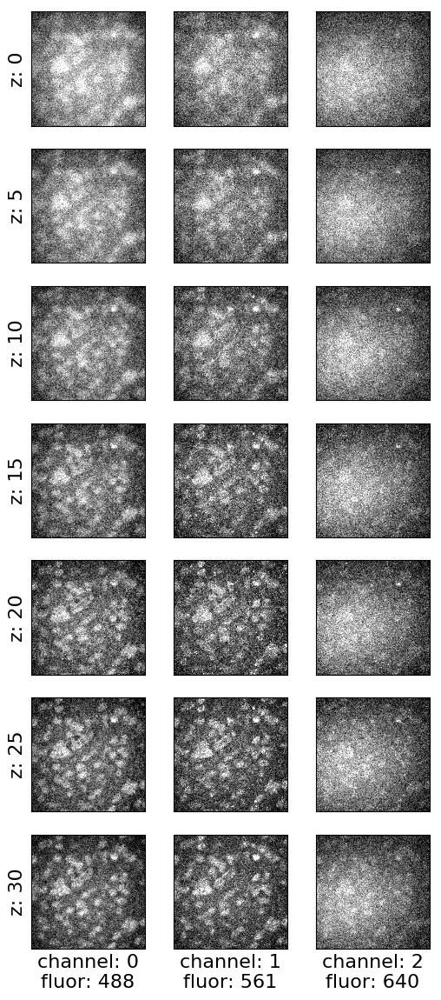

In [33]:
"""
Visualize channels x z-stack subset

note: 
-----
it would be great to be able to explicitly label which dimensions of the image we want to 
unfurl on the y and x axes, and to be able to sample images from them. Here I wanted to
view channel and z-section in a grid. 
"""

width = 6
aspect_ratio = 7 / 3
height = width * aspect_ratio
f, axes = plt.subplots(7, 3, figsize=(width, height))

z_sections = np.arange(subset.shape[0])
channels = np.arange(subset.shape[1])

for z in z_sections:
    for ch in channels:
        vmin, vmax = clim[ch]
        ax = axes[z, ch]
        ax.imshow(subset[z, ch, :, :], vmin=vmin, vmax=vmax, cmap=plt.cm.gray)
        ax.set_xticks([])
        ax.set_yticks([])
        if z == max(z_sections):
            ax.set_xlabel('channel: %d\nfluor: %s' % (ch, ch_to_fluor_mapping[ch]), fontsize=16)
        if ch == min(channels):
            ax.set_ylabel('z: %d' % (z * 5), fontsize=16)            

Write a bit of code to visualize dynamic ranges of the same images -- they're very different!

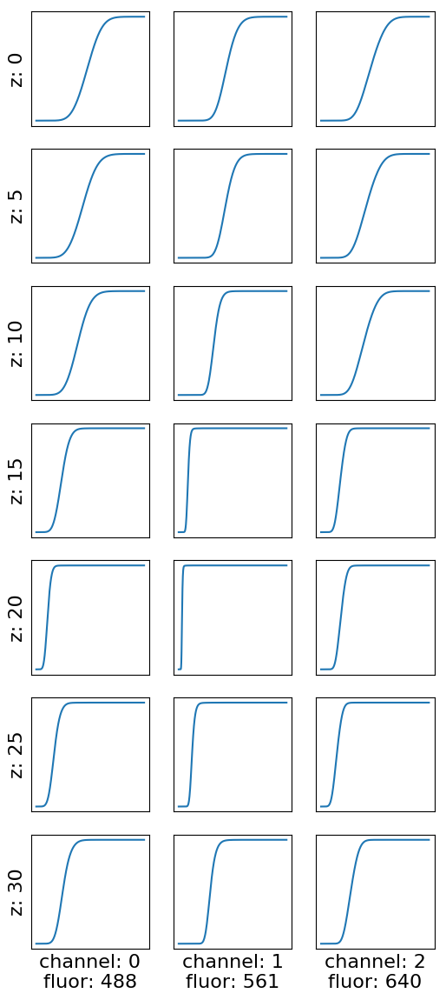

In [32]:
width = 6
aspect_ratio = 7 / 3
height = width * aspect_ratio
f, axes = plt.subplots(7, 3, figsize=(width, height))

z_sections = np.arange(subset.shape[0])
channels = np.arange(subset.shape[1])

for z in z_sections:
    for ch in channels:
        ax = axes[z, ch]
        y, x = cumulative_distribution(subset[z, ch, :, :])
        ax.plot(x, y)
        ax.set_xticks([])
        ax.set_yticks([])
        if z == max(z_sections):
            ax.set_xlabel('channel: %d\nfluor: %s' % (ch, ch_to_fluor_mapping[ch]), fontsize=16)
        if ch == min(channels):
            ax.set_ylabel('z: %d' % (z * 5), fontsize=16)

I think this suggests we need to do some kind of normalization of the channels _and_ the z-sections. I'm not doing that right now -- did I miss something in Brian's pipeline code? 

For the next section, I look at an individual z-section that seems like it has "middle-of-the-road" s:n. 

In [214]:
def clip_vis2d(img, vmin=1, vmax=99, ax=None, size=7):
    """wrapper for showit image with a percentile-based clip"""
    clim = np.percentile(img, [vmin, vmax])
    return image(img, clim=clim, ax=ax, size=size)

In [205]:
def plot_spots(img, result_df, z, vmin=1, vmax=99, ax=None, size=2):
    """function to plot the results from brian's pipeline on top of any image, 
    
    called spots are colored by category 
    
    Parameters:
    -----------
    img: np.ndarray
      2-d image
    result_df: pd.Dataframe
      result dataframe containing spot calls that correspond to the image channel
    z: int
      z-plane to plot spot calls for
    vmin, vmax: int
      clipping thresholds for the image plot
    ax, matplotlib.Axes.Axis
    
    """
    if ax is None:
        _, ax = plt.subplots(figsize=(15, 15))
    clip_vis2d(img, vmin=vmin, vmax=vmax, ax=ax)
    
    # round the results df z values to the nearest integer section id
    # we'll plot these indices
    inds = np.round(result_df['z']) == z
    
    # get the data needed to plot
    selected = result_df.loc[inds, ['radius^2', 'x', 'y', 'category']]
    grouped_by_peak_type = selected.groupby('category')
    colors = ['r', 'c', 'y']

    for color, (_, group) in zip(colors, grouped_by_peak_type):
        for i in np.arange(group.shape[0]):
            r, x, y, _ = group.iloc[i, :]  # radius is a duplicate, and is present twice
            c = plt.Circle((y, x), r * 10, color=color, linewidth=size, fill=False)
            ax.add_patch(c)
    
    return ax

This is equivalent to the first background clipping that Brian does, but adds a removal of the top percentile

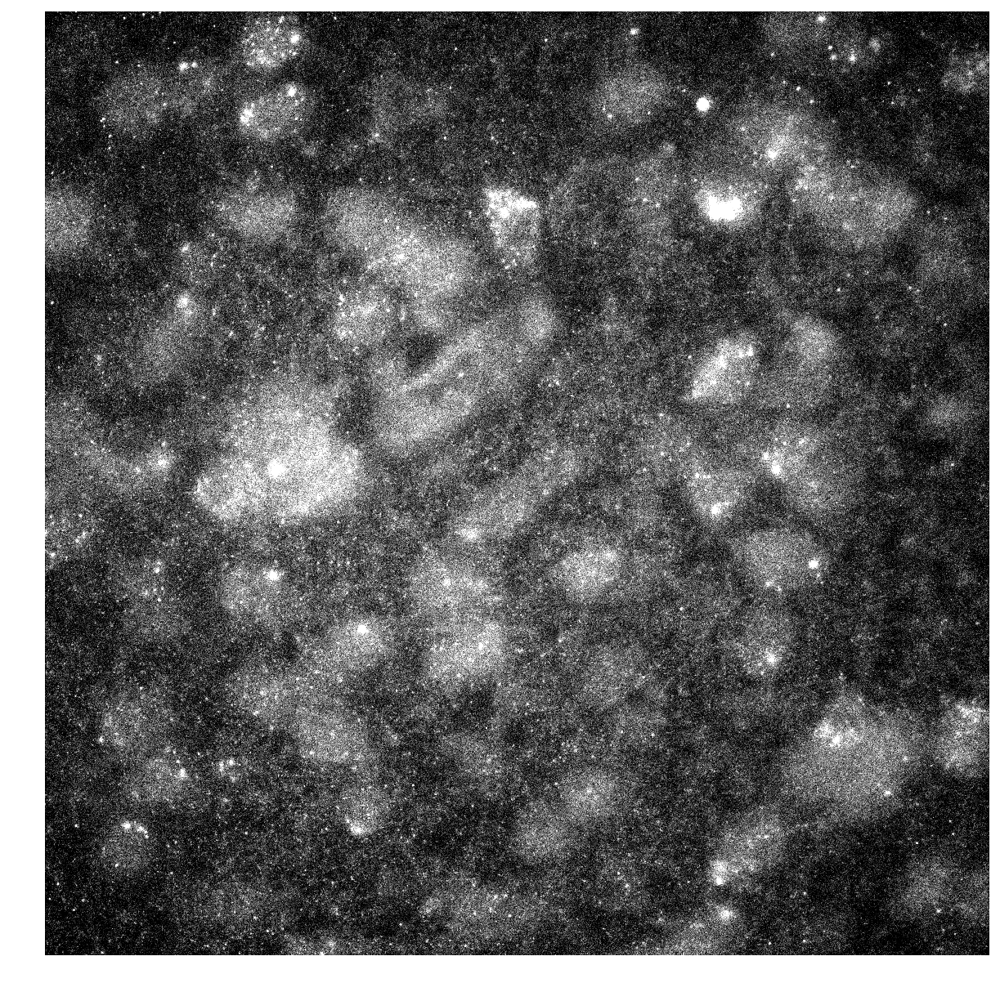

In [179]:
# get an image
img = s.image.numpy_array[0, 1, :, :, 15]

clip_vis2d(img, 10, 99, size=15)

As far as I can tell, only spots are being called on the left side of the image. Some kind of issue with high-pass filtering, perhaps? 

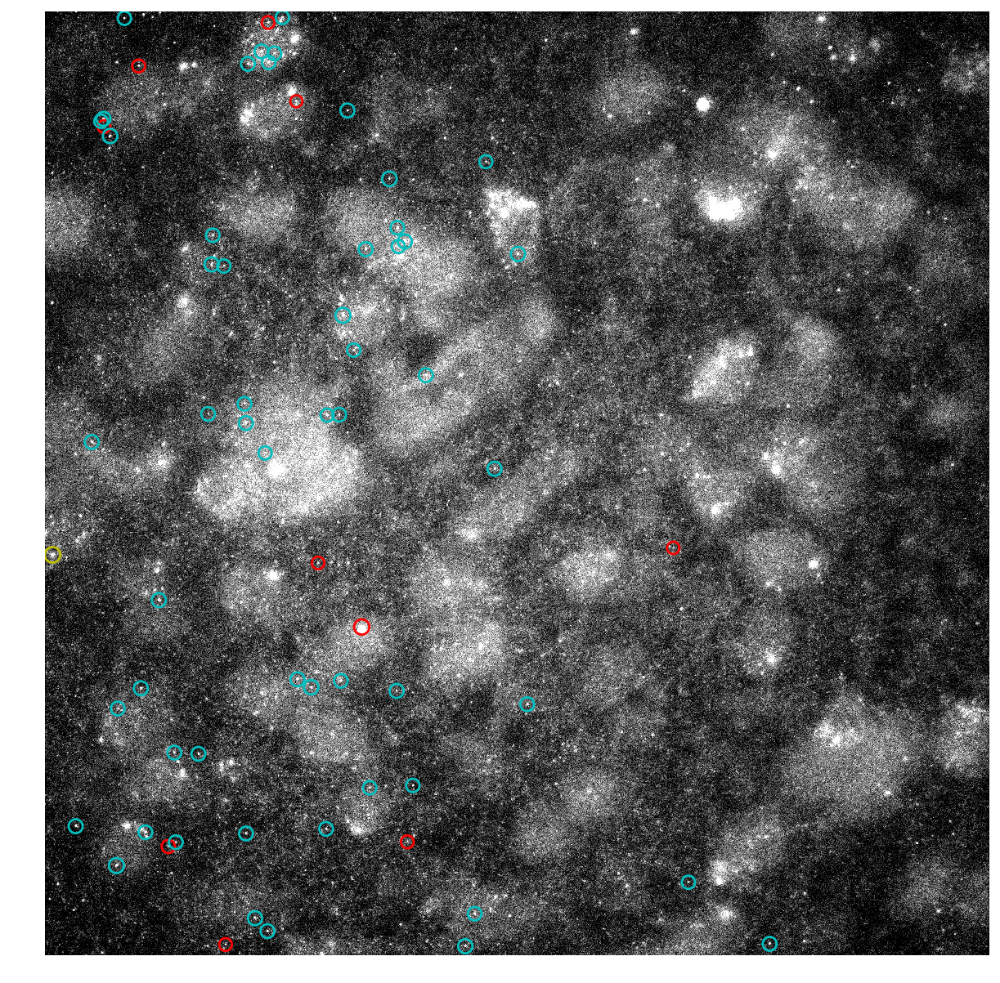

In [206]:
plot_spots(img, res_561, 15, 10, 99)

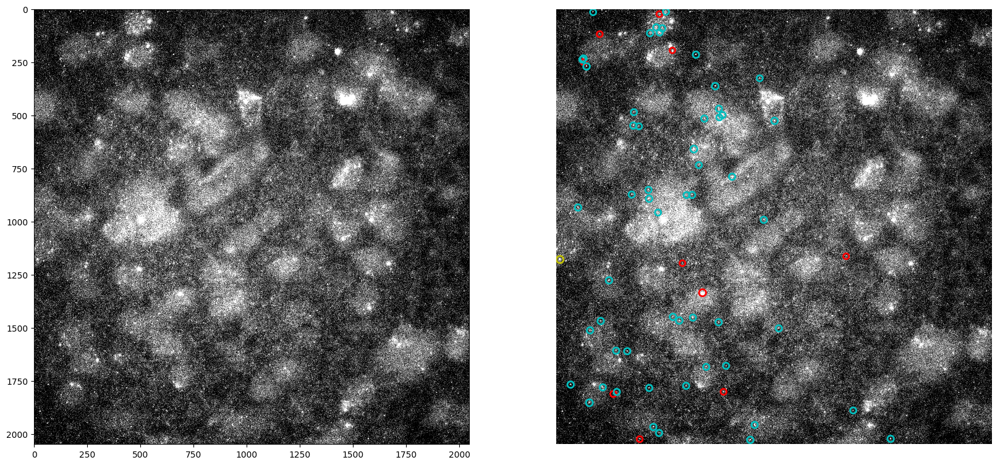

In [209]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 40))
clip_vis2d(img, 10, 99, ax=ax1);
plot_spots(img, res_561, z, 10, 99, ax=ax2);

Here are both images side by side

# Reproduce this result with skimage/trackpy/scipy.ndimage code that we could pull into starfish

He used trackpy to find spots (https://soft-matter.github.io/trackpy/v0.3.2/)

We think this is similar: http://scikit-image.org/docs/dev/auto_examples/segmentation/plot_peak_local_max.html

## Define the filtering functions Brian uses and try to get those functions to work!

In [79]:
def floor_image_percentile(img, percentile=10):
    """pre-clip the image"""
    target = np.percentile(img, 10)
    return img.clip(target) - target

In [80]:
def blong_bandpass(img):
    """
    carries out a bandpass filter with parameters set as defined in particleFinder and particleFinder2.py
    
    Parameters
    ----------
    img, np.ndarray[np.uint16]
    
    Notes
    -----
    - uses trackpy bandpass filter as implemented
    - 1.5 lshort is too much (comment in code)
    - similar to white top hat filtering? 
    """
    threshold = 1

    bandpass_result = bandpass(
        image=img,
        lshort=0.5,  # from particleFinder2.py
        llong=5,  # strelRadius from particleFinder.py
        threshold=1,  # postBandpassThreshold
        truncate=4, # truncate is left as default (4)
    )    
    return bandpass_result

In [81]:
def post_clip(img, threshold=1):
    """post-clip the image after band-passing"""
    img = img.clip(min=threshold)
    img -= threshold
    return img

First, run the pre-clipping method. This seems to do a reasonable job of removing background. 

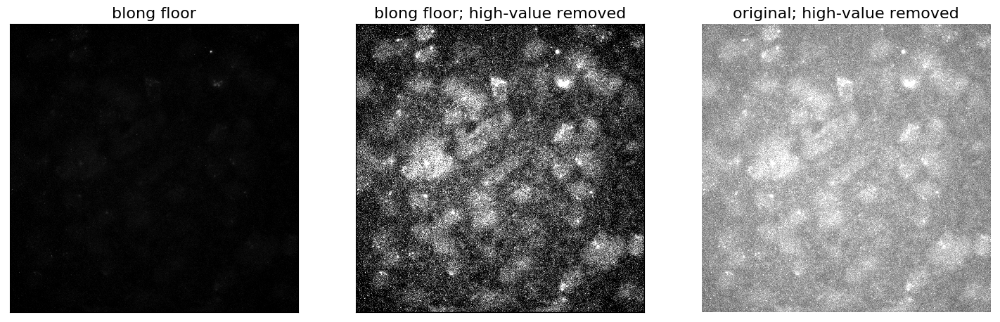

In [83]:
floored_ = floor_image_percentile(img)
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

image(floored_, ax=ax1)
clip_vis2d(floored_, vmin=0, vmax=99, ax=ax2)
clip_vis2d(img, vmin=0, vmax=99, ax=ax3)

for ax in (ax1, ax2, ax3):
    ax.set_xticks([]), ax.set_yticks([])

ax1.set_title('blong floor', fontsize=16);
ax2.set_title('blong floor; high-value removed', fontsize=16);
ax3.set_title('original; high-value removed', fontsize=16);

Next, run the bandpass filter.

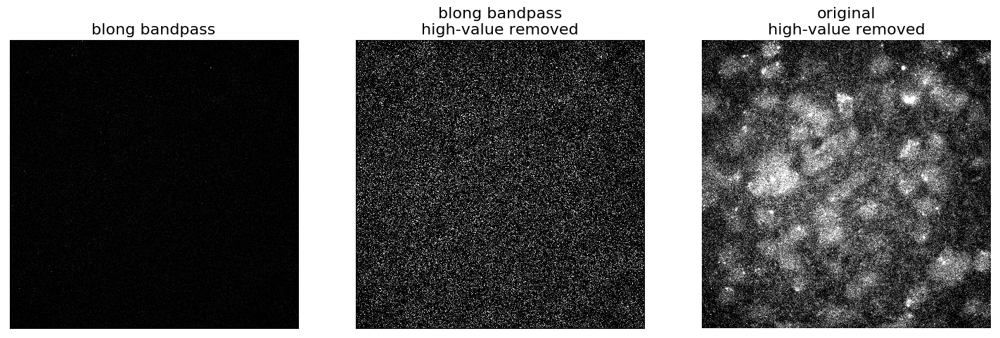

In [86]:
bp_ = blong_bandpass(floored_)
f, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(18, 6))

image(bp_, ax=ax1)
clip_vis2d(bp_, vmin=0, vmax=99, ax=ax2);
clip_vis2d(floored_, vmin=0, vmax=99, ax=ax3)

for ax in (ax1, ax2, ax3):
    ax.set_xticks([]), ax.set_yticks([])
    
ax1.set_title('blong bandpass', fontsize=16);
ax2.set_title('blong bandpass\nhigh-value removed', fontsize=16);
ax3.set_title('original\nhigh-value removed', fontsize=16);

In my hands, bandpass turns the images into noise.

# Alternatives

We can make the bandpass look a bit better with different parameters, but overall I'm confused about:
1. Why bandpass is appropriate for this data
2. How background thresholding can be done more adaptively to account for autofluorescence

I have no guarantee that the below approach works well across the entire z-stack, but I've implemented an approach that appears to identify a super-set of the spots in this image. 

A digression: this is a gaussian convolution + a stricter background. 

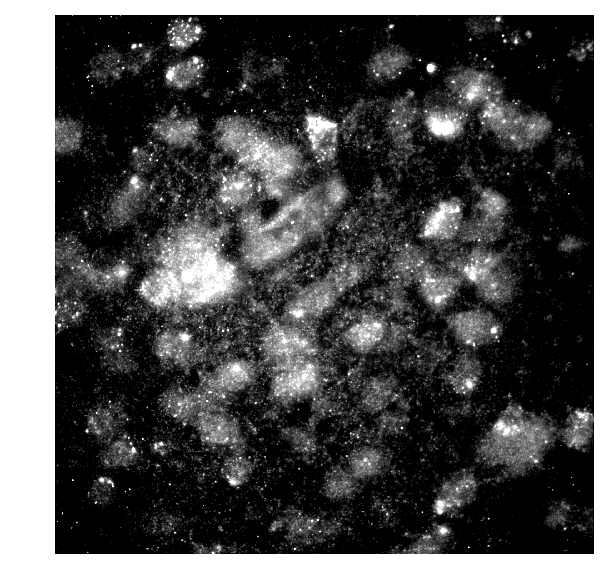

In [88]:
filtered_ = ndimage.gaussian_filter(img, 1.5)
min, max = np.percentile(filtered_, [40, 99])
clipped_ = filtered_.clip(int(min), int(max))
image(clipped_)

The mini-pipeline:
    
1. convolve with small gaussian
2. use otsu filtering to adaptively find peaks
3. white top-hat filter to remove large spots
4. use peak local max to turn the mask into a series of spots

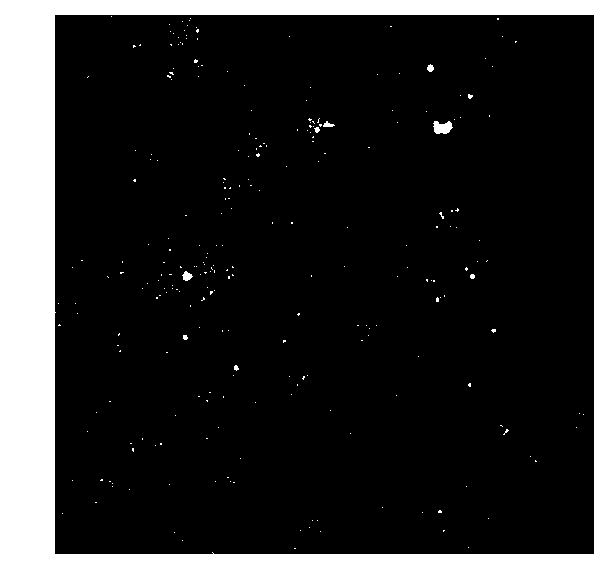

In [145]:
with warnings.catch_warnings():
    warnings.simplefilter('ignore', UserWarning)
    _, otsu_ = cv2.threshold(img_as_ubyte(filtered_), 0, 255, cv2.THRESH_OTSU)

image(otsu_)

Try out some different morphological element sizes

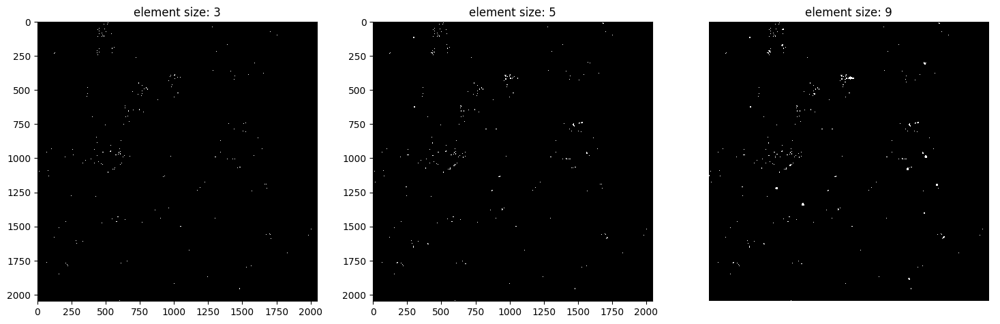

In [132]:
f, axes = plt.subplots(1, 3, figsize=(18, 6))
element_sizes = (3, 5, 9)
results = [white_tophat(otsu_, disk(n)) for n in element_sizes]
for ax, result, elem in zip(axes, results, element_sizes):
    image(result, ax=ax)
    ax.set_title('element size: %d' % elem)

Plot the called peaks on the size=3 disk element results

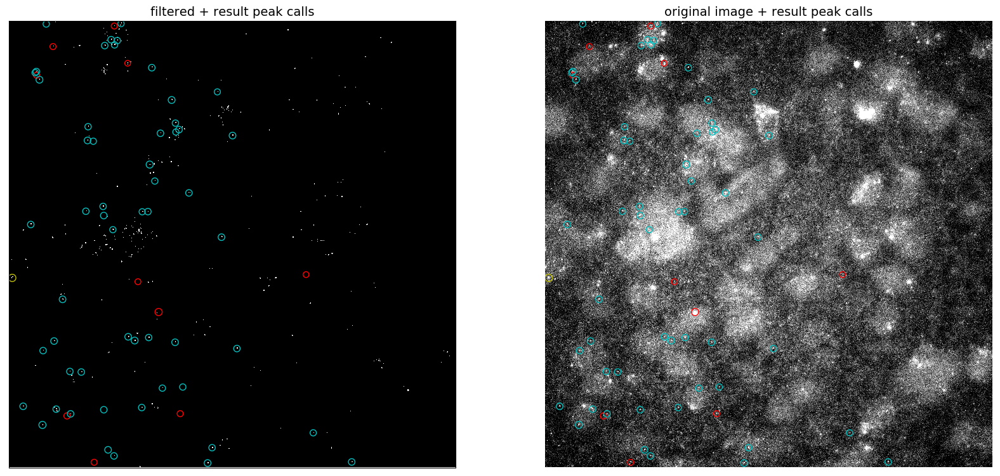

In [210]:
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
plot_spots(results[0], res_561, 15, vmin=0, vmax=100, ax=ax1, size=1)
plot_spots(img, res_561, 15, vmin=10, vmax=99, ax=ax2, size=1)
for ax in (ax1, ax2):
    ax.set_xticks([]), ax.set_yticks([])
ax1.set_title('filtered + result peak calls', fontsize=14);
ax2.set_title('original image + result peak calls', fontsize=14);

# Run some tests

## Does this approach find reasonable peaks in a different z-section of same channel?

In [161]:
def blong_mini_pipeline(stack, z, channel, results_df, plot_original=True):
    ch = fluor_to_file_mapping[channel]
    img = stack.image.numpy_array[0, ch, :, :, z]
    filtered_ = ndimage.gaussian_filter(img, 1.5)
    with warnings.catch_warnings():
        warnings.simplefilter('ignore', UserWarning)
        _, otsu_ = cv2.threshold(img_as_ubyte(filtered_), 0, 255, cv2.THRESH_OTSU)
    wth_ = white_tophat(otsu_, disk(3))
    
    if plot_original:
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 10))
        plot_spots(img, results_df, z, vmin=10, vmax=99, ax=ax2, size=1)
    else:
        f, ax1 = plt.subplots(figsize=(10,10))
    plot_spots(wth_, results_df, z, vmin=0, vmax=100, ax=ax1, size=1)

In [150]:
# where are the spots in each section?
Counter(np.round(res_561['z']))

Counter({14.0: 3,
         15.0: 66,
         16.0: 172,
         17.0: 226,
         18.0: 182,
         19.0: 203,
         20.0: 123,
         21.0: 115,
         22.0: 115,
         23.0: 68,
         24.0: 69,
         25.0: 77,
         26.0: 56,
         27.0: 43,
         28.0: 40,
         29.0: 35,
         30.0: 27,
         31.0: 15})

This one has the most spots, we agree quite well. 

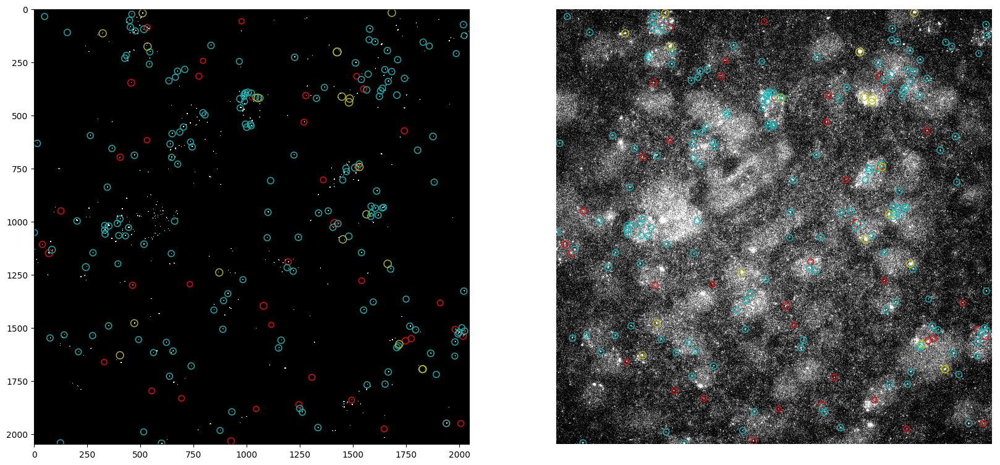

In [211]:
blong_mini_pipeline(s, 17, "561", res_561)

This one is far away, and there is more disagreement.

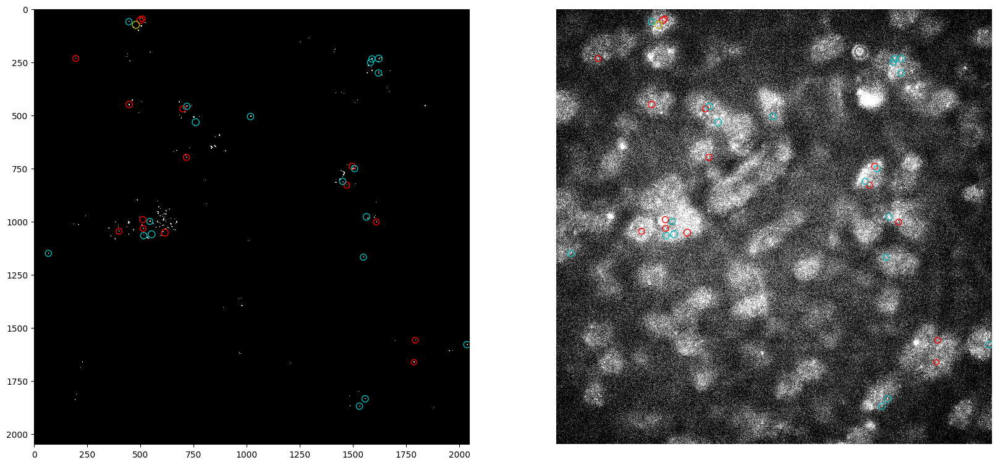

In [212]:
blong_mini_pipeline(s, 29, "561", res_561)

Try another channel that has good s:n

In [155]:
Counter(round(res_488['z']))

Counter({15.0: 2,
         16.0: 30,
         17.0: 61,
         18.0: 65,
         19.0: 64,
         20.0: 60,
         21.0: 34,
         22.0: 35,
         23.0: 25,
         24.0: 16,
         25.0: 14,
         26.0: 14,
         27.0: 2,
         28.0: 4,
         29.0: 4,
         30.0: 2,
         31.0: 3})

I think the "generalization" tests show that at the very least the way I'm doing this requires better parameter tuning. See e.g. below:

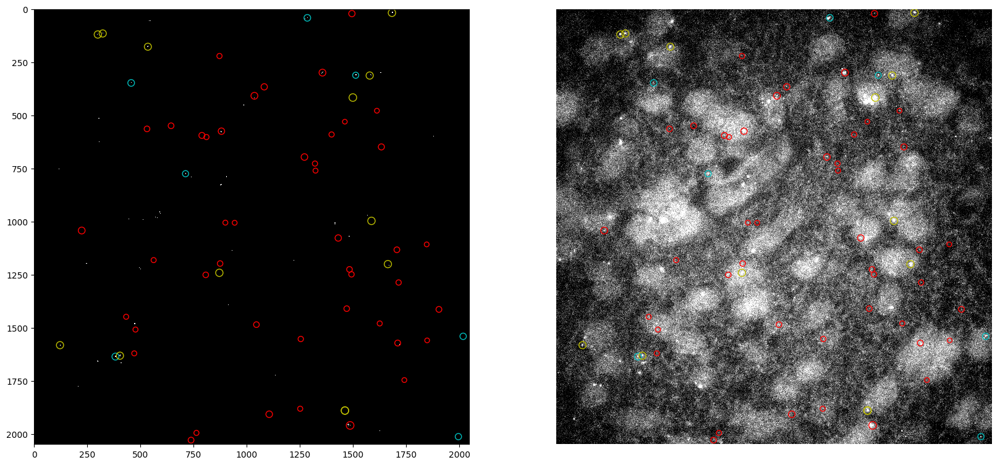

In [213]:
blong_mini_pipeline(s, 18, "488", res_488)

## Appendix 1: Define some inefficient functions to apply 1d functions over a full FOV

In [23]:
def two_to_three_d(tensor3d, func2d):
    """tensors are x, y, z still"""
    result = np.zeros_like(tensor3d)
    
    z = tensor3d.shape[-1]
    for i in np.arange(z):
        result[:, :, i] = func2d(tensor3d[:, :, i])
    return result

In [24]:
def stack_apply(stack: Stack, func3d, verbose=True):
    """apply func3d over the 3d tensor defined by each hyb and channel, returning a new stack
    
    func3d should be a partial function that takes only one parameter: the 3d tensor
    """
    
    # make the new stack
    new_stack = deepcopy(stack)
    n_hybs, n_channels, *_ = stack.image.shape
    
    # apply over each 3d tensor
    for hyb in np.arange(n_hybs):
        for channel in np.arange(n_channels):
            hyb_view = stack.image.numpy_array[hyb, channel, :]
            new_stack.image._data[hyb, channel, :] = func3d(hyb_view)
            if verbose:
                print("finished processing hyb %d, channel %d" % (hyb, channel))
    return new_stack

In [25]:
def func3d(stack, func2d): 
    return stack_apply(
        stack=stack,
        func3d=partial(two_to_three_d, func2d=func2d)
    )